In [1]:
from dataclasses import dataclass

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from lagrangian import LagrangianSolver
import torch

from IPython.display import HTML

In [2]:
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'

plt.rc('font', family='serif', serif="cmr10", size=18)
plt.rc('mathtext', fontset='cm', rm='serif')
plt.rc('axes', unicode_minus=False)

plt.rcParams['axes.formatter.use_mathtext'] = True

# Simple Pendulum

In [62]:
@dataclass
class Pendulum(LagrangianSolver):
    m: float        # [kg] mass `m` suspended
    L: float        # [m] at length `L`
    g: float=9.81   # [m/s]

    def T(self, u: torch.Tensor) -> torch.Tensor:
        (t, theta, theta_dot) = u
        return self.m * self.L**2 * theta_dot.square()/2
    
    def V(self, u: torch.Tensor) -> torch.Tensor:
        (t, theta, theta_dot) = u
        return self.m * self.g * theta.square()/2 #(1-theta.cos())

In [78]:
u0 = (theta0, theta_dot0) = torch.tensor([np.pi/4, 0.], dtype=torch.float64)

T = 300
N = 30_000
t = torch.linspace(0,T,N)

solver = Pendulum(m=1., L=1.)
t, u, E = solver.solve(u0, t)

100%|██████████| 29999/29999 [01:46<00:00, 280.57it/s]


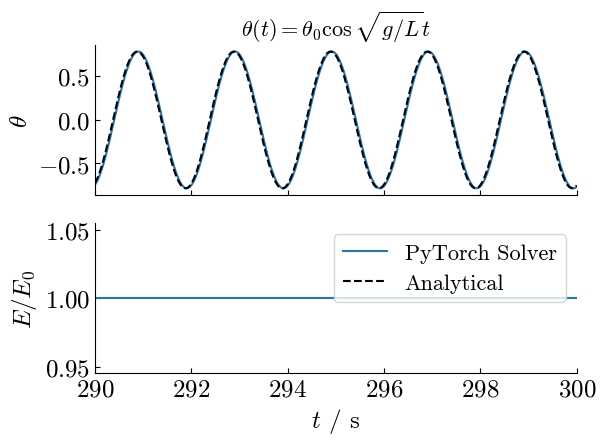

In [ ]:
fig, ax = plt.subplots(2, 1, sharex=True)


ax[0].plot(t, u[:,0])
ax[0].plot(t, theta0*np.cos(np.sqrt(solver.g/solver.L)*t), 'k--')

ax[1].plot(t,E/E[0], label='PyTorch Solver')
ax[1].plot(0,1, 'k--', label='Analytical')

ax[0].set_title(r'$\theta(t)=\theta_0\cos \sqrt{g/L}t$', size=16)
ax[0].set_ylabel(r'$\theta$')
ax[1].set_ylabel(r'$E/E_0$')
ax[1].set_xlabel('$t$ / s')
ax[1].legend(loc='upper right', fontsize=16)
ax[0].set_xlim(290,300)

fig.tight_layout()
# fig.savefig('SHO.svg')

In [109]:
t_sub = t[-1000:].detach().numpy()
y_soln = u[:,0][-1000:].detach().numpy()
y_ex = (theta0*np.cos(np.sqrt(solver.g/solver.L)*t_sub)).detach().numpy()

In [118]:
T = 10
fs = len(y_soln) / T

In [ ]:
corr = np.correlate(y_soln - np.mean(y_soln), y_ex - np.mean(y_ex), mode='full')

lag = np.argmax(corr) - (len(y_soln) - 1)

# phase-shift
lag/fs

0.01

# Damped Simple Harmonic Oscilator

In [3]:
@dataclass
class DampedPendulum(LagrangianSolver):
    m: float        # [kg] mass `m` suspended
    L: float        # [m] at length `L`
    c: float        # [-] damping coefficient
    g: float=9.81   # [m/s]

    def T(self, u: torch.Tensor) -> torch.Tensor:
        (t, theta, theta_dot) = u
        return self.m * self.L**2 * theta_dot.square()/2
    
    def V(self, u: torch.Tensor) -> torch.Tensor:
        (t, theta, theta_dot) = u
        return self.m * self.g * theta.square()/2#(1-theta.cos())
    
    def Q(self, u: torch.Tensor) -> torch.Tensor:
        (t, theta, theta_dot) = u
        return self.c*theta_dot.square()/2

In [4]:
u0 = (theta0, theta_dot0) = torch.tensor([0.1, 0.], dtype=torch.float64)

T = 10
N = 250
t = torch.linspace(0,T,N)

solver = DampedPendulum(m=1., L=1., c=1.)
t, u, E = solver.solve(u0, t)

100%|██████████| 249/249 [00:00<00:00, 274.90it/s]


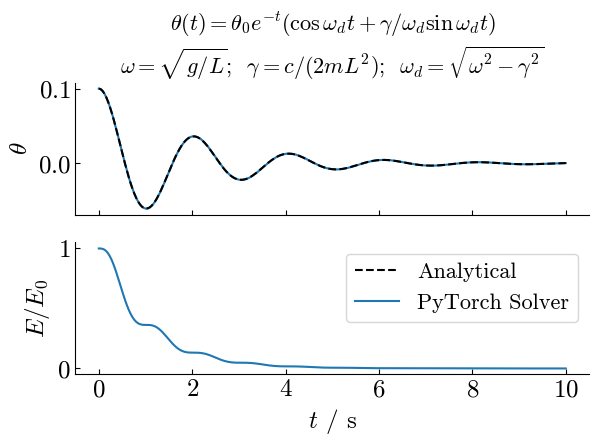

In [ ]:
omega = np.sqrt(solver.g/solver.L)
gamma = solver.c /(2*solver.m*solver.L**2)

omega_d = np.sqrt(omega**2 - gamma**2)

theta_ex = lambda t : (
    theta0 * np.exp(-gamma*t) * (
        np.cos(omega_d*t) + gamma/omega_d*np.sin(omega_d*t)
    ) 
)

eq = ''

fig, ax = plt.subplots(2, 1, sharex=True)

ax[0].plot(t, u[:,0])
ax[0].plot(t, theta_ex(t), 'k--', label=r'')
ax[1].plot(0,1 , 'k--', label='Analytical')
ax[1].plot(t, E/E[0], label='PyTorch Solver')
ax[0].set_ylabel(r'$\theta$')
ax[1].set_ylabel(r'$E/E_0$')
ax[1].set_xlabel('$t$ / s')
ax[1].legend(fontsize=16)

ax[0].set_title(
    r'$\theta(t) = \theta_0 e^{-t}(\cos \omega_d t + \gamma/\omega_d \sin\omega_d t)$' +'\n' + 
    r'$\omega = \sqrt{g/L}$;  $\gamma = c/(2mL^2)$;  $\omega_d = \sqrt{\omega^2 - \gamma^2}$', 
    size=16
)

fig.tight_layout()
# fig.savefig('./assets/damped-SHO.svg')

In [7]:
@dataclass
class Dzhanibekov(LagrangianSolver):
    R: float
    m1: float
    m2: float

    def T(self, u: torch.Tensor):
        t, x1,y1,z1, x2,y2,z2, xdot1,ydot1,zdot1, xdot2,ydot2,zdot2 = u

        r2_1 = x1.square() + y1.square() + z1.square()
        r2dot_1 = xdot1.square() + ydot1.square() + zdot1.square()

        r2_2 = x2.square() + y2.square() + z2.square()
        r2dot_2 = xdot2.square() + ydot2.square() + zdot2.square()

        r2_geo = x1*x2 + y1*y2 + z1*z2
        rdot2_geo = xdot1*xdot2 + ydot1*ydot2 + zdot1*zdot2
        
        lambda1 = -self.m1/self.R**2 * r2dot_1
        lambda2 = -self.m2/self.R**2 * r2dot_2
        gamma = -4*(rdot2_geo)/self.R**2 * self.m1*self.m2/(self.m1 + self.m2)

        return (
            self.m1 * (xdot1.square() + ydot1.square() + zdot1.square()) + 
            self.m2 * (xdot2.square() + ydot2.square() + zdot2.square()) + 
            lambda1 * (r2_1 - self.R**2) +
            lambda2 * (r2_2 - self.R**2) + 
            gamma   * (r2_geo)
        )

    def V(self, u: torch.Tensor):
        return torch.tensor(0., dtype=torch.float64)

In [ ]:
T = 50
N = 1000
t = torch.linspace(0,T,N)

u0 = torch.tensor([
    0., 0., 1., # (x1, y1, z1)
    1., 0., 0., # (x2, y2, z2)
    0., 0., 0., # (xdot1, ydot1, zdot1)
    0., 1., 0.01, # (xdot2, ydot2, zdot2)
], dtype=torch.float64)

solver = Dzhanibekov(R=1., m1=.1, m2=1.)
t, u, E = solver.solve(u0, t)

  5%|▍         | 46/999 [00:02<00:54, 17.36it/s]

In [21]:
x1,y1,z1, x2,y2,z2, xdot1,ydot1,zdot1, xdot2,ydot2,zdot2 = u.T

x1, y1, z1 = map(np.ravel, (x1, y1, z1))
x2, y2, z2 = map(np.ravel, (x2, y2, z2))

fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_zlim(-1, 1)

ax.grid(False)
ax.set_xticks([-1,0,1])
ax.set_yticks([-1,0,1])
ax.set_zticks([-1,0,1])

trail1, = ax.plot([], [], [], lw=2, alpha=.2)
trail2, = ax.plot([], [], [], lw=2, alpha=.2)

body1, = ax.plot([], [], [], 'C0o-')
body2, = ax.plot([], [], [], 'C1o-')


def animate(i):
    idx = min(2*i, len(t))
    trail1.set_data(x1[:idx], y1[:idx])
    trail1.set_3d_properties(z1[:idx])

    body1.set_data([x1[idx], -x1[idx]], [y1[idx], -y1[idx]])
    body1.set_3d_properties([z1[idx], -z1[idx]])

    trail2.set_data(x2[:idx], y2[:idx])
    trail2.set_3d_properties(z2[:idx])

    body2.set_data([x2[idx], -x2[idx]], [y2[idx], -y2[idx]])
    body2.set_3d_properties([z2[idx], -z2[idx]])

    return (trail1,)

ani = animation.FuncAnimation(fig, animate, frames=len(t)//2, blit=True)

plt.close()
HTML(ani.to_jshtml())


Animation size has reached 20993972 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
